# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: data: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

In [20]:
XXXX = np.rollaxis(trainset['X'], 3)
XXXX.shape

(73257, 32, 32, 3)

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

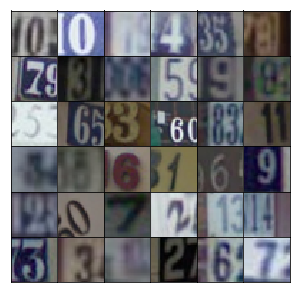

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*1024)
        x = tf.reshape(x, (-1, 4, 4, 1024))
        
        layer = x
        for i in range(1, 4):
            filters = int(1024 / (2**i)) if i < 3 else 3
            kernel_size = 5
            strides = 2
            layer = tf.layers.batch_normalization(layer, training=training)
            layer = tf.maximum(alpha * layer, layer)
            layer = tf.layers.conv2d_transpose(layer, filters, kernel_size, strides=strides, padding='same')
        
        # Output layer, 32x32x3
        logits = layer
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [32]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        assert x.shape[1:] == (32, 32, 3), 'wrong shape: {}'.format(x.shape)
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 32, 3, strides=2, padding='same')
        x = tf.maximum(alpha * x, x)
        
        layer = x
        
        for i in range(1, 3):
            filters = 32 * (2**i)
            kernel_size = 3
            strides = 2
            layer = tf.layers.conv2d(layer, filters, kernel_size, strides=strides, padding='same')
            layer = tf.layers.batch_normalization(layer, training=True)
            layer = tf.maximum(alpha * layer, layer)

        assert layer.shape[1:] == (4, 4, 128), 'wrong shape: {}'.format(layer.get_shape())
        # Flatten it
        flattened = tf.reshape(layer, (-1, 4*4*128))
        logits = tf.layers.dense(flattened, 1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [33]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real))*.9)
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [34]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [35]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [36]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [37]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [ ]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 7.0704... Generator Loss: 0.0016
Epoch 1/25... Discriminator Loss: 6.9323... Generator Loss: 0.0019
Epoch 1/25... Discriminator Loss: 6.9587... Generator Loss: 0.0019
Epoch 1/25... Discriminator Loss: 6.7453... Generator Loss: 0.0028
Epoch 1/25... Discriminator Loss: 5.6464... Generator Loss: 0.0104
Epoch 1/25... Discriminator Loss: 5.1902... Generator Loss: 0.0160
Epoch 1/25... Discriminator Loss: 3.9089... Generator Loss: 0.0674
Epoch 1/25... Discriminator Loss: 5.5077... Generator Loss: 0.0161
Epoch 1/25... Discriminator Loss: 5.2484... Generator Loss: 0.0192
Epoch 1/25... Discriminator Loss: 4.9866... Generator Loss: 0.0276


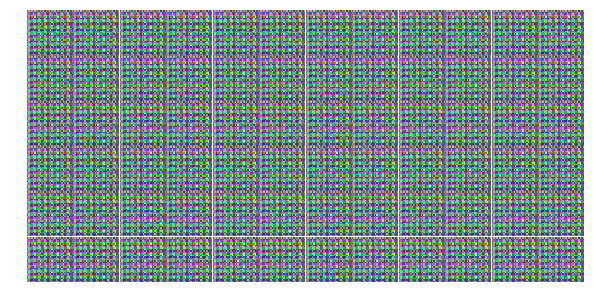

Epoch 1/25... Discriminator Loss: 4.1570... Generator Loss: 0.0484
Epoch 1/25... Discriminator Loss: 2.8606... Generator Loss: 0.2337
Epoch 1/25... Discriminator Loss: 3.9927... Generator Loss: 0.0728
Epoch 1/25... Discriminator Loss: 3.8990... Generator Loss: 0.1005
Epoch 1/25... Discriminator Loss: 3.5529... Generator Loss: 0.1512
Epoch 1/25... Discriminator Loss: 3.3236... Generator Loss: 0.1302
Epoch 1/25... Discriminator Loss: 2.6878... Generator Loss: 0.2501
Epoch 1/25... Discriminator Loss: 2.6651... Generator Loss: 0.2720
Epoch 1/25... Discriminator Loss: 3.1279... Generator Loss: 0.2212
Epoch 1/25... Discriminator Loss: 2.5526... Generator Loss: 0.2555


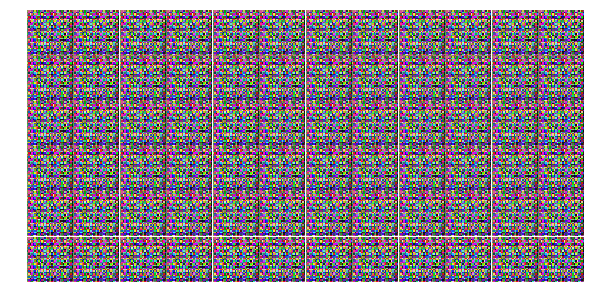

Epoch 1/25... Discriminator Loss: 1.7575... Generator Loss: 0.8567
Epoch 1/25... Discriminator Loss: 2.4736... Generator Loss: 0.3618
Epoch 1/25... Discriminator Loss: 2.1141... Generator Loss: 0.5373
Epoch 1/25... Discriminator Loss: 1.2768... Generator Loss: 0.9364
Epoch 1/25... Discriminator Loss: 1.4793... Generator Loss: 0.7059
Epoch 1/25... Discriminator Loss: 1.6857... Generator Loss: 0.4877
Epoch 1/25... Discriminator Loss: 1.8251... Generator Loss: 0.4001
Epoch 1/25... Discriminator Loss: 1.4621... Generator Loss: 0.7217
Epoch 1/25... Discriminator Loss: 1.4382... Generator Loss: 1.0009
Epoch 1/25... Discriminator Loss: 1.2642... Generator Loss: 0.9441


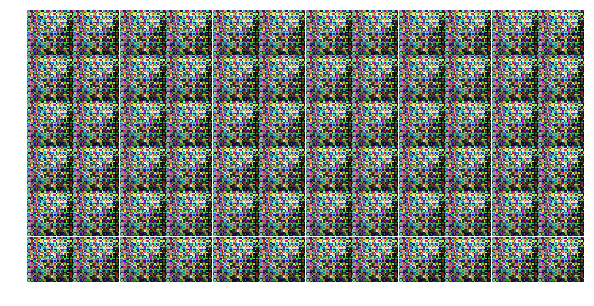

Epoch 1/25... Discriminator Loss: 1.3181... Generator Loss: 0.8184
Epoch 1/25... Discriminator Loss: 1.3689... Generator Loss: 0.5990
Epoch 1/25... Discriminator Loss: 1.4595... Generator Loss: 0.6657
Epoch 1/25... Discriminator Loss: 1.4112... Generator Loss: 0.8180
Epoch 1/25... Discriminator Loss: 1.4989... Generator Loss: 0.7369
Epoch 1/25... Discriminator Loss: 1.2259... Generator Loss: 0.8490
Epoch 1/25... Discriminator Loss: 1.4745... Generator Loss: 0.6195
Epoch 1/25... Discriminator Loss: 1.9000... Generator Loss: 0.8157
Epoch 1/25... Discriminator Loss: 1.1698... Generator Loss: 1.0350
Epoch 1/25... Discriminator Loss: 1.0744... Generator Loss: 1.2770


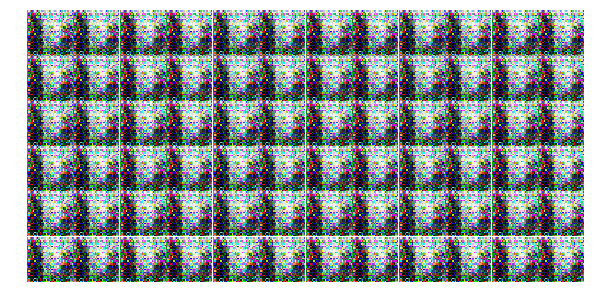

Epoch 1/25... Discriminator Loss: 1.1477... Generator Loss: 0.8955
Epoch 1/25... Discriminator Loss: 1.4221... Generator Loss: 0.7655
Epoch 1/25... Discriminator Loss: 1.2334... Generator Loss: 0.8854
Epoch 1/25... Discriminator Loss: 1.3303... Generator Loss: 0.8372
Epoch 1/25... Discriminator Loss: 1.3831... Generator Loss: 0.8074
Epoch 1/25... Discriminator Loss: 0.9859... Generator Loss: 1.0067
Epoch 1/25... Discriminator Loss: 1.1720... Generator Loss: 0.8904
Epoch 1/25... Discriminator Loss: 1.3641... Generator Loss: 0.8947
Epoch 1/25... Discriminator Loss: 1.2166... Generator Loss: 0.9804
Epoch 1/25... Discriminator Loss: 0.7561... Generator Loss: 1.4727


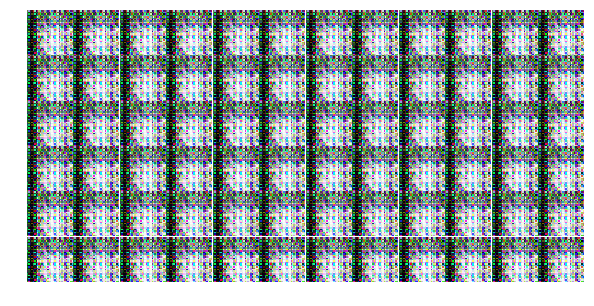

Epoch 1/25... Discriminator Loss: 0.8096... Generator Loss: 1.3151
Epoch 1/25... Discriminator Loss: 0.6472... Generator Loss: 1.2813
Epoch 1/25... Discriminator Loss: 0.7136... Generator Loss: 1.1366
Epoch 1/25... Discriminator Loss: 1.0798... Generator Loss: 0.8030
Epoch 1/25... Discriminator Loss: 1.0109... Generator Loss: 1.0930
Epoch 1/25... Discriminator Loss: 0.9681... Generator Loss: 1.0460
Epoch 1/25... Discriminator Loss: 0.9197... Generator Loss: 1.0208
Epoch 2/25... Discriminator Loss: 0.7159... Generator Loss: 1.3922
Epoch 2/25... Discriminator Loss: 0.9598... Generator Loss: 1.4738
Epoch 2/25... Discriminator Loss: 0.8507... Generator Loss: 1.0469


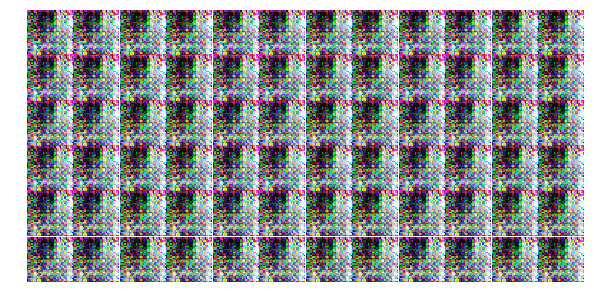

Epoch 2/25... Discriminator Loss: 0.8893... Generator Loss: 0.9731
Epoch 2/25... Discriminator Loss: 1.1048... Generator Loss: 1.0485
Epoch 2/25... Discriminator Loss: 0.8131... Generator Loss: 1.1960
Epoch 2/25... Discriminator Loss: 0.7778... Generator Loss: 1.3676
Epoch 2/25... Discriminator Loss: 0.5165... Generator Loss: 1.6653
Epoch 2/25... Discriminator Loss: 0.6578... Generator Loss: 1.4701
Epoch 2/25... Discriminator Loss: 0.5430... Generator Loss: 1.5258
Epoch 2/25... Discriminator Loss: 1.0269... Generator Loss: 0.8190
Epoch 2/25... Discriminator Loss: 0.9034... Generator Loss: 1.1146
Epoch 2/25... Discriminator Loss: 0.5832... Generator Loss: 1.4097


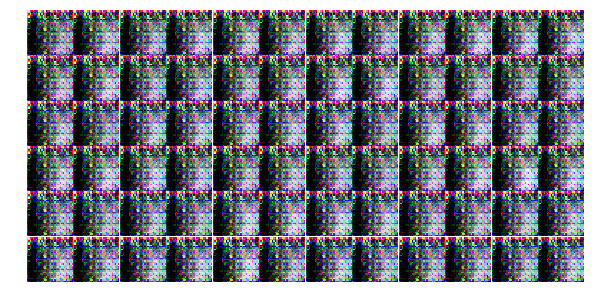

Epoch 2/25... Discriminator Loss: 0.6243... Generator Loss: 1.4678
Epoch 2/25... Discriminator Loss: 0.5637... Generator Loss: 1.5892
Epoch 2/25... Discriminator Loss: 0.9252... Generator Loss: 1.0719
Epoch 2/25... Discriminator Loss: 1.5778... Generator Loss: 0.6524
Epoch 2/25... Discriminator Loss: 1.9754... Generator Loss: 0.5590
Epoch 2/25... Discriminator Loss: 1.9111... Generator Loss: 0.5569
Epoch 2/25... Discriminator Loss: 1.6579... Generator Loss: 0.6510
Epoch 2/25... Discriminator Loss: 2.1027... Generator Loss: 0.4864
Epoch 2/25... Discriminator Loss: 2.0721... Generator Loss: 0.4934
Epoch 2/25... Discriminator Loss: 1.3761... Generator Loss: 1.2335


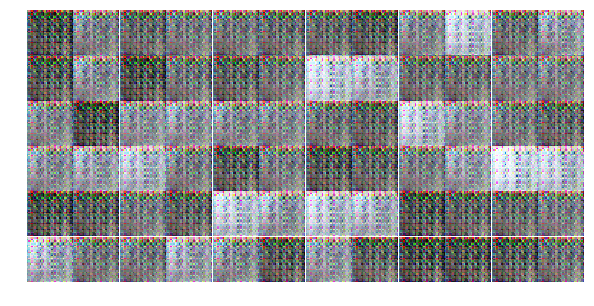

Epoch 2/25... Discriminator Loss: 1.9566... Generator Loss: 0.4963
Epoch 2/25... Discriminator Loss: 1.9810... Generator Loss: 0.4276
Epoch 2/25... Discriminator Loss: 1.8211... Generator Loss: 0.6164
Epoch 2/25... Discriminator Loss: 1.8244... Generator Loss: 0.5661
Epoch 2/25... Discriminator Loss: 1.7706... Generator Loss: 0.5727
Epoch 2/25... Discriminator Loss: 1.7670... Generator Loss: 0.5721
Epoch 2/25... Discriminator Loss: 1.6545... Generator Loss: 0.5820
Epoch 2/25... Discriminator Loss: 1.6611... Generator Loss: 0.5783
Epoch 2/25... Discriminator Loss: 1.6256... Generator Loss: 0.5912
Epoch 2/25... Discriminator Loss: 1.5732... Generator Loss: 0.6625


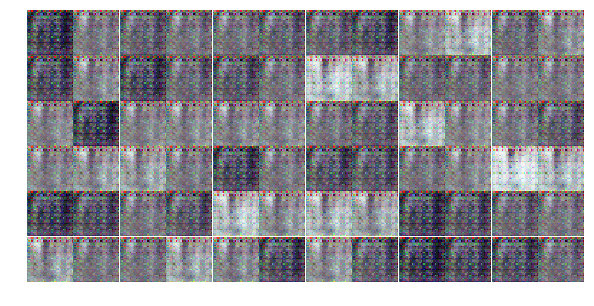

Epoch 2/25... Discriminator Loss: 1.4821... Generator Loss: 0.6579
Epoch 2/25... Discriminator Loss: 1.4705... Generator Loss: 0.6782
Epoch 2/25... Discriminator Loss: 1.4983... Generator Loss: 0.6610
Epoch 2/25... Discriminator Loss: 1.5087... Generator Loss: 0.6489
Epoch 2/25... Discriminator Loss: 1.4877... Generator Loss: 0.6735
Epoch 2/25... Discriminator Loss: 1.4804... Generator Loss: 0.6677
Epoch 2/25... Discriminator Loss: 1.5449... Generator Loss: 0.6447
Epoch 2/25... Discriminator Loss: 1.5619... Generator Loss: 0.6431
Epoch 2/25... Discriminator Loss: 1.5694... Generator Loss: 0.6231
Epoch 2/25... Discriminator Loss: 1.4981... Generator Loss: 0.6639


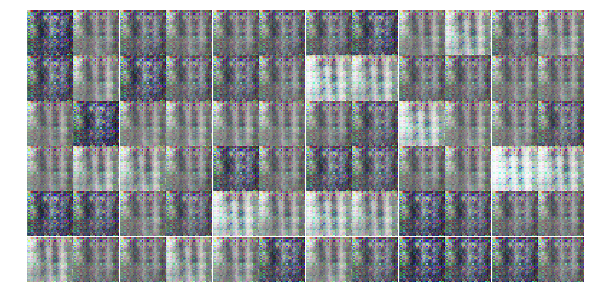

Epoch 2/25... Discriminator Loss: 1.4644... Generator Loss: 0.6837
Epoch 2/25... Discriminator Loss: 1.5191... Generator Loss: 0.6710
Epoch 2/25... Discriminator Loss: 1.4849... Generator Loss: 0.6794
Epoch 2/25... Discriminator Loss: 1.4640... Generator Loss: 0.6769
Epoch 2/25... Discriminator Loss: 1.4631... Generator Loss: 0.6687
Epoch 2/25... Discriminator Loss: 1.4507... Generator Loss: 0.6861
Epoch 2/25... Discriminator Loss: 1.4115... Generator Loss: 0.7156
Epoch 2/25... Discriminator Loss: 1.4043... Generator Loss: 0.7184
Epoch 2/25... Discriminator Loss: 1.6396... Generator Loss: 0.5569
Epoch 2/25... Discriminator Loss: 1.6203... Generator Loss: 0.7017


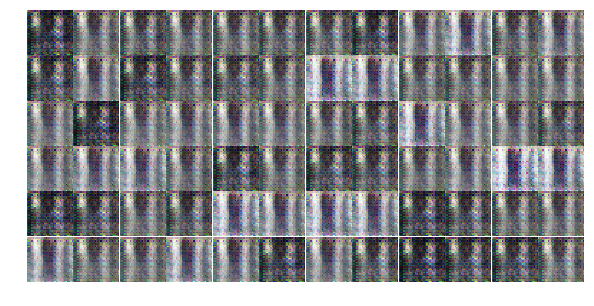

Epoch 2/25... Discriminator Loss: 1.4893... Generator Loss: 0.6872
Epoch 2/25... Discriminator Loss: 1.4210... Generator Loss: 0.7173
Epoch 2/25... Discriminator Loss: 1.3917... Generator Loss: 0.7262
Epoch 2/25... Discriminator Loss: 1.3589... Generator Loss: 0.7157
Epoch 3/25... Discriminator Loss: 1.4551... Generator Loss: 0.6945
Epoch 3/25... Discriminator Loss: 1.3653... Generator Loss: 0.7319
Epoch 3/25... Discriminator Loss: 1.3757... Generator Loss: 0.7245
Epoch 3/25... Discriminator Loss: 1.4360... Generator Loss: 0.7151
Epoch 3/25... Discriminator Loss: 1.5579... Generator Loss: 0.6165
Epoch 3/25... Discriminator Loss: 1.7521... Generator Loss: 0.5813


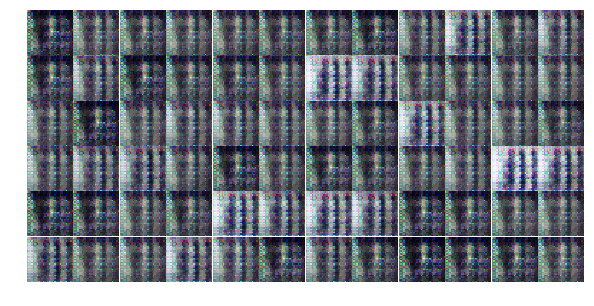

Epoch 3/25... Discriminator Loss: 1.3832... Generator Loss: 0.7370
Epoch 3/25... Discriminator Loss: 1.4759... Generator Loss: 0.6528
Epoch 3/25... Discriminator Loss: 1.3544... Generator Loss: 0.7615
Epoch 3/25... Discriminator Loss: 1.3277... Generator Loss: 0.7722
Epoch 3/25... Discriminator Loss: 1.3859... Generator Loss: 0.6936
Epoch 3/25... Discriminator Loss: 1.4968... Generator Loss: 0.6394
Epoch 3/25... Discriminator Loss: 1.5413... Generator Loss: 0.6711
Epoch 3/25... Discriminator Loss: 1.4395... Generator Loss: 0.7477
Epoch 3/25... Discriminator Loss: 1.3812... Generator Loss: 0.7110
Epoch 3/25... Discriminator Loss: 1.4294... Generator Loss: 0.7178


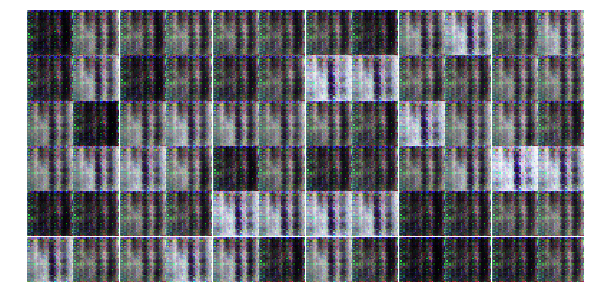

Epoch 3/25... Discriminator Loss: 1.4105... Generator Loss: 0.6988
Epoch 3/25... Discriminator Loss: 1.4031... Generator Loss: 0.7065
Epoch 3/25... Discriminator Loss: 1.3947... Generator Loss: 0.6922
Epoch 3/25... Discriminator Loss: 1.4163... Generator Loss: 0.6822
Epoch 3/25... Discriminator Loss: 1.4425... Generator Loss: 0.6697
Epoch 3/25... Discriminator Loss: 1.4921... Generator Loss: 0.6573
Epoch 3/25... Discriminator Loss: 1.4210... Generator Loss: 0.7611
Epoch 3/25... Discriminator Loss: 1.3588... Generator Loss: 0.7576
Epoch 3/25... Discriminator Loss: 1.3418... Generator Loss: 0.7454
Epoch 3/25... Discriminator Loss: 1.4148... Generator Loss: 0.6785


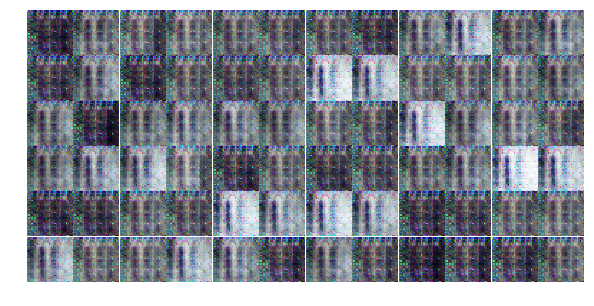

Epoch 3/25... Discriminator Loss: 1.4113... Generator Loss: 0.7266
Epoch 3/25... Discriminator Loss: 1.4380... Generator Loss: 0.6763
Epoch 3/25... Discriminator Loss: 1.4243... Generator Loss: 0.7414
Epoch 3/25... Discriminator Loss: 1.4174... Generator Loss: 0.6885
Epoch 3/25... Discriminator Loss: 1.3830... Generator Loss: 0.7257
Epoch 3/25... Discriminator Loss: 1.3817... Generator Loss: 0.7125
Epoch 3/25... Discriminator Loss: 1.3944... Generator Loss: 0.7010
Epoch 3/25... Discriminator Loss: 1.3892... Generator Loss: 0.7113
Epoch 3/25... Discriminator Loss: 1.3670... Generator Loss: 0.7200
Epoch 3/25... Discriminator Loss: 1.3768... Generator Loss: 0.7287


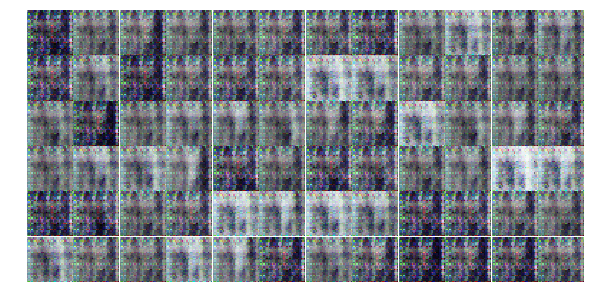

Epoch 3/25... Discriminator Loss: 1.2945... Generator Loss: 0.7605
Epoch 3/25... Discriminator Loss: 1.5141... Generator Loss: 0.6330
Epoch 3/25... Discriminator Loss: 1.3919... Generator Loss: 0.7020
Epoch 3/25... Discriminator Loss: 1.4750... Generator Loss: 0.6904
Epoch 3/25... Discriminator Loss: 1.3387... Generator Loss: 0.7525
Epoch 3/25... Discriminator Loss: 1.3687... Generator Loss: 0.6875
Epoch 3/25... Discriminator Loss: 1.4200... Generator Loss: 0.6926
Epoch 3/25... Discriminator Loss: 1.4177... Generator Loss: 0.6979
Epoch 3/25... Discriminator Loss: 1.4283... Generator Loss: 0.6791
Epoch 3/25... Discriminator Loss: 1.4228... Generator Loss: 0.7032


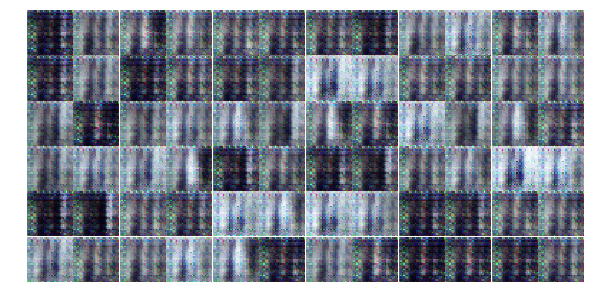

Epoch 3/25... Discriminator Loss: 1.3529... Generator Loss: 0.7490
Epoch 3/25... Discriminator Loss: 1.3380... Generator Loss: 0.7314
Epoch 3/25... Discriminator Loss: 1.3821... Generator Loss: 0.6752
Epoch 3/25... Discriminator Loss: 1.4054... Generator Loss: 0.7064
Epoch 3/25... Discriminator Loss: 1.4234... Generator Loss: 0.6920
Epoch 3/25... Discriminator Loss: 1.3823... Generator Loss: 0.7128
Epoch 3/25... Discriminator Loss: 1.4014... Generator Loss: 0.7015
Epoch 3/25... Discriminator Loss: 1.3861... Generator Loss: 0.7076
Epoch 3/25... Discriminator Loss: 1.3770... Generator Loss: 0.7181
Epoch 3/25... Discriminator Loss: 1.3857... Generator Loss: 0.7092


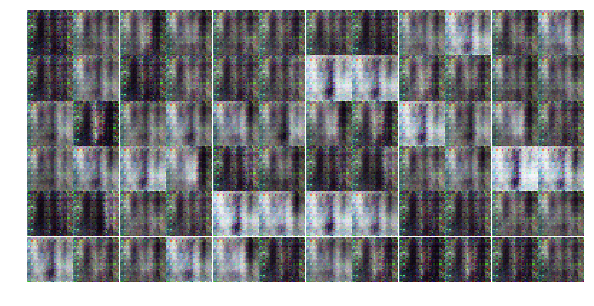

Epoch 3/25... Discriminator Loss: 1.3830... Generator Loss: 0.7037
Epoch 4/25... Discriminator Loss: 1.3635... Generator Loss: 0.7234
Epoch 4/25... Discriminator Loss: 1.3700... Generator Loss: 0.7215
Epoch 4/25... Discriminator Loss: 1.3583... Generator Loss: 0.7082
Epoch 4/25... Discriminator Loss: 1.4396... Generator Loss: 0.6754
Epoch 4/25... Discriminator Loss: 1.3781... Generator Loss: 0.7369
Epoch 4/25... Discriminator Loss: 1.3270... Generator Loss: 0.7490
Epoch 4/25... Discriminator Loss: 1.3851... Generator Loss: 0.7060
Epoch 4/25... Discriminator Loss: 1.3938... Generator Loss: 0.7309
Epoch 4/25... Discriminator Loss: 1.3612... Generator Loss: 0.7289


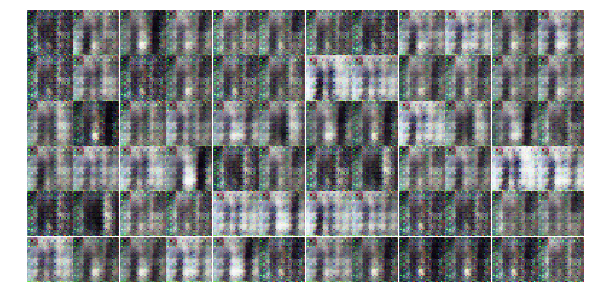

Epoch 4/25... Discriminator Loss: 1.4494... Generator Loss: 0.6903
Epoch 4/25... Discriminator Loss: 1.3487... Generator Loss: 0.7676
Epoch 4/25... Discriminator Loss: 1.3682... Generator Loss: 0.7253
Epoch 4/25... Discriminator Loss: 1.3996... Generator Loss: 0.7126
Epoch 4/25... Discriminator Loss: 1.3622... Generator Loss: 0.7041
Epoch 4/25... Discriminator Loss: 1.3998... Generator Loss: 0.7036
Epoch 4/25... Discriminator Loss: 1.3616... Generator Loss: 0.7173
Epoch 4/25... Discriminator Loss: 1.3593... Generator Loss: 0.7235
Epoch 4/25... Discriminator Loss: 1.4008... Generator Loss: 0.7100
Epoch 4/25... Discriminator Loss: 1.3086... Generator Loss: 0.7489


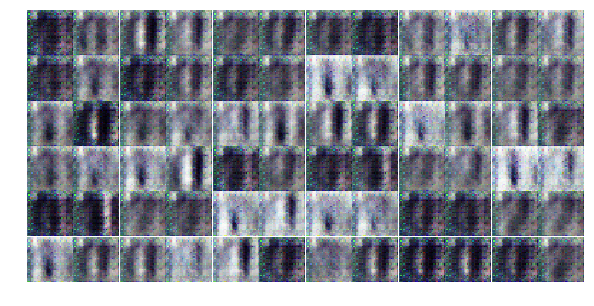

Epoch 4/25... Discriminator Loss: 1.3755... Generator Loss: 0.7074
Epoch 4/25... Discriminator Loss: 1.3916... Generator Loss: 0.7096
Epoch 4/25... Discriminator Loss: 1.3782... Generator Loss: 0.7126
Epoch 4/25... Discriminator Loss: 1.3587... Generator Loss: 0.7373
Epoch 4/25... Discriminator Loss: 1.3641... Generator Loss: 0.7316
Epoch 4/25... Discriminator Loss: 1.3445... Generator Loss: 0.7347
Epoch 4/25... Discriminator Loss: 1.3376... Generator Loss: 0.7465
Epoch 4/25... Discriminator Loss: 1.3664... Generator Loss: 0.7163
Epoch 4/25... Discriminator Loss: 1.3839... Generator Loss: 0.7062
Epoch 4/25... Discriminator Loss: 1.3516... Generator Loss: 0.7398


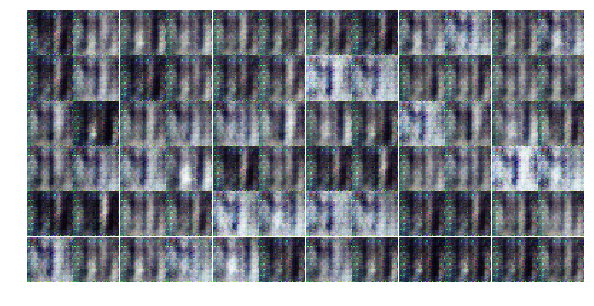

Epoch 4/25... Discriminator Loss: 1.3526... Generator Loss: 0.7131
Epoch 4/25... Discriminator Loss: 1.4107... Generator Loss: 0.7000
Epoch 4/25... Discriminator Loss: 1.2639... Generator Loss: 0.7659
Epoch 4/25... Discriminator Loss: 1.3330... Generator Loss: 0.7358
Epoch 4/25... Discriminator Loss: 1.3573... Generator Loss: 0.7180
Epoch 4/25... Discriminator Loss: 1.4191... Generator Loss: 0.7159
Epoch 4/25... Discriminator Loss: 1.3644... Generator Loss: 0.7566
Epoch 4/25... Discriminator Loss: 1.3693... Generator Loss: 0.7258
Epoch 4/25... Discriminator Loss: 1.3921... Generator Loss: 0.7102
Epoch 4/25... Discriminator Loss: 1.3509... Generator Loss: 0.7523


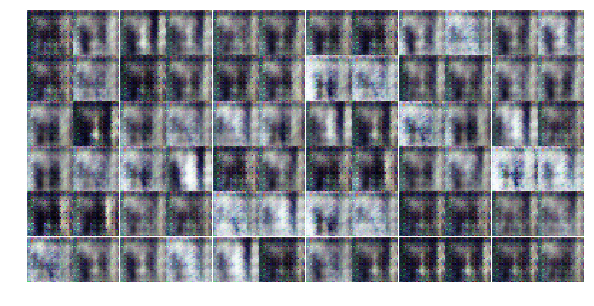

Epoch 4/25... Discriminator Loss: 1.3413... Generator Loss: 0.7278
Epoch 4/25... Discriminator Loss: 1.3861... Generator Loss: 0.7103
Epoch 4/25... Discriminator Loss: 1.3952... Generator Loss: 0.7024
Epoch 4/25... Discriminator Loss: 1.3525... Generator Loss: 0.7319
Epoch 4/25... Discriminator Loss: 1.3284... Generator Loss: 0.7522
Epoch 4/25... Discriminator Loss: 1.4225... Generator Loss: 0.6768
Epoch 4/25... Discriminator Loss: 1.3543... Generator Loss: 0.7141
Epoch 4/25... Discriminator Loss: 1.3609... Generator Loss: 0.7384
Epoch 4/25... Discriminator Loss: 1.3811... Generator Loss: 0.7106
Epoch 4/25... Discriminator Loss: 1.4305... Generator Loss: 0.6891


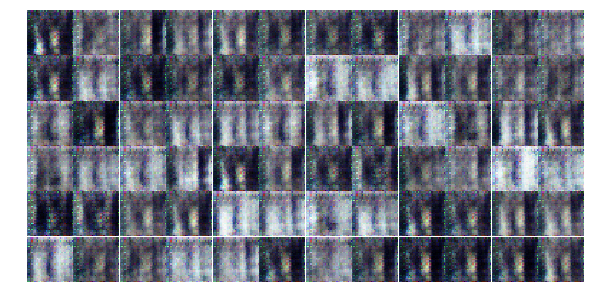

Epoch 4/25... Discriminator Loss: 1.3382... Generator Loss: 0.7467
Epoch 4/25... Discriminator Loss: 1.3671... Generator Loss: 0.7199
Epoch 4/25... Discriminator Loss: 1.3186... Generator Loss: 0.7576
Epoch 4/25... Discriminator Loss: 1.3334... Generator Loss: 0.7251
Epoch 4/25... Discriminator Loss: 1.3649... Generator Loss: 0.7169
Epoch 4/25... Discriminator Loss: 1.3202... Generator Loss: 0.7427
Epoch 4/25... Discriminator Loss: 1.3633... Generator Loss: 0.7156
Epoch 4/25... Discriminator Loss: 1.3411... Generator Loss: 0.7422
Epoch 4/25... Discriminator Loss: 1.4024... Generator Loss: 0.6883
Epoch 5/25... Discriminator Loss: 1.3273... Generator Loss: 0.7603


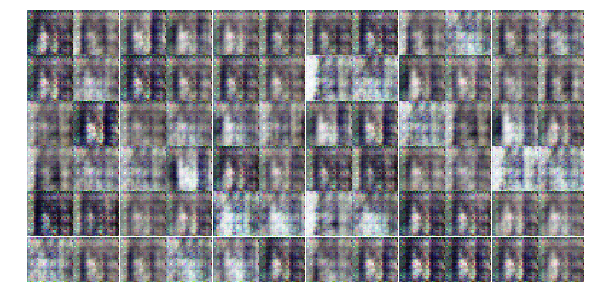

Epoch 5/25... Discriminator Loss: 1.3412... Generator Loss: 0.7157
Epoch 5/25... Discriminator Loss: 1.3802... Generator Loss: 0.7104
Epoch 5/25... Discriminator Loss: 1.3665... Generator Loss: 0.7144
Epoch 5/25... Discriminator Loss: 1.3608... Generator Loss: 0.7223
Epoch 5/25... Discriminator Loss: 1.3311... Generator Loss: 0.7474
Epoch 5/25... Discriminator Loss: 1.3269... Generator Loss: 0.7345
Epoch 5/25... Discriminator Loss: 1.3476... Generator Loss: 0.7432
Epoch 5/25... Discriminator Loss: 1.3349... Generator Loss: 0.7390
Epoch 5/25... Discriminator Loss: 1.3485... Generator Loss: 0.7349
Epoch 5/25... Discriminator Loss: 1.3520... Generator Loss: 0.7226


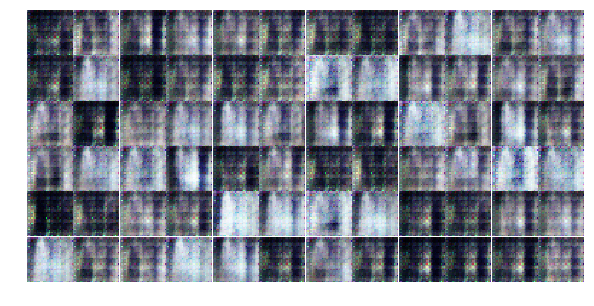

Epoch 5/25... Discriminator Loss: 1.3332... Generator Loss: 0.7439
Epoch 5/25... Discriminator Loss: 1.3612... Generator Loss: 0.7153
Epoch 5/25... Discriminator Loss: 1.3455... Generator Loss: 0.7716
Epoch 5/25... Discriminator Loss: 1.3118... Generator Loss: 0.7378
Epoch 5/25... Discriminator Loss: 1.3863... Generator Loss: 0.7216
Epoch 5/25... Discriminator Loss: 1.3670... Generator Loss: 0.7333
Epoch 5/25... Discriminator Loss: 1.3311... Generator Loss: 0.7569
Epoch 5/25... Discriminator Loss: 1.2963... Generator Loss: 0.7404
Epoch 5/25... Discriminator Loss: 1.3450... Generator Loss: 0.7315
Epoch 5/25... Discriminator Loss: 1.3209... Generator Loss: 0.7378


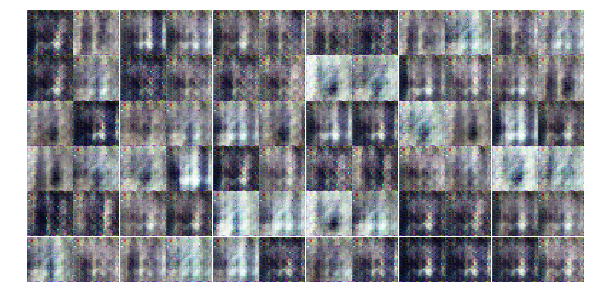

Epoch 5/25... Discriminator Loss: 1.3357... Generator Loss: 0.7246
Epoch 5/25... Discriminator Loss: 1.3398... Generator Loss: 0.7292
Epoch 5/25... Discriminator Loss: 1.3440... Generator Loss: 0.7238
Epoch 5/25... Discriminator Loss: 1.3767... Generator Loss: 0.7226
Epoch 5/25... Discriminator Loss: 1.3176... Generator Loss: 0.7759
Epoch 5/25... Discriminator Loss: 1.3203... Generator Loss: 0.7341
Epoch 5/25... Discriminator Loss: 1.3419... Generator Loss: 0.7281
Epoch 5/25... Discriminator Loss: 1.3521... Generator Loss: 0.7194
Epoch 5/25... Discriminator Loss: 1.3280... Generator Loss: 0.7373
Epoch 5/25... Discriminator Loss: 1.3623... Generator Loss: 0.7220


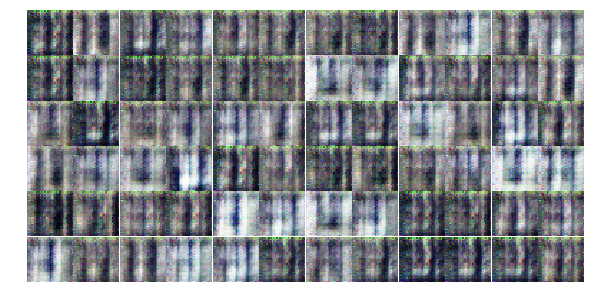

Epoch 5/25... Discriminator Loss: 1.3164... Generator Loss: 0.7668
Epoch 5/25... Discriminator Loss: 1.3217... Generator Loss: 0.7332
Epoch 5/25... Discriminator Loss: 1.3132... Generator Loss: 0.7442
Epoch 5/25... Discriminator Loss: 1.3751... Generator Loss: 0.7164
Epoch 5/25... Discriminator Loss: 1.3356... Generator Loss: 0.7445
Epoch 5/25... Discriminator Loss: 1.3543... Generator Loss: 0.7142
Epoch 5/25... Discriminator Loss: 1.3041... Generator Loss: 0.8074
Epoch 5/25... Discriminator Loss: 1.3759... Generator Loss: 0.6930
Epoch 5/25... Discriminator Loss: 1.3254... Generator Loss: 0.7594
Epoch 5/25... Discriminator Loss: 1.3197... Generator Loss: 0.7350


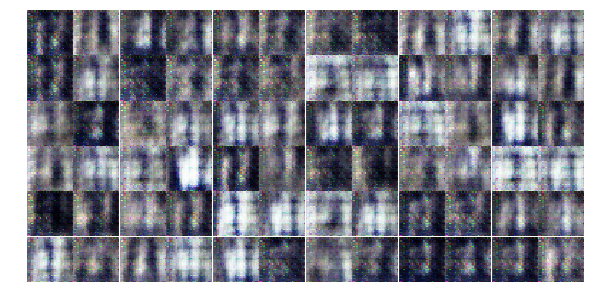

Epoch 5/25... Discriminator Loss: 1.3700... Generator Loss: 0.7151
Epoch 5/25... Discriminator Loss: 1.3541... Generator Loss: 0.7370
Epoch 5/25... Discriminator Loss: 1.3756... Generator Loss: 0.7073
Epoch 5/25... Discriminator Loss: 1.3215... Generator Loss: 0.7346
Epoch 5/25... Discriminator Loss: 1.4105... Generator Loss: 0.7046
Epoch 5/25... Discriminator Loss: 1.2979... Generator Loss: 0.7725
Epoch 5/25... Discriminator Loss: 1.3197... Generator Loss: 0.7419
Epoch 5/25... Discriminator Loss: 1.3225... Generator Loss: 0.7117
Epoch 5/25... Discriminator Loss: 1.3474... Generator Loss: 0.7262
Epoch 5/25... Discriminator Loss: 1.3305... Generator Loss: 0.7490


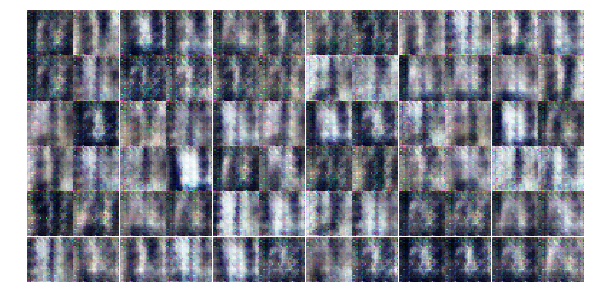

Epoch 5/25... Discriminator Loss: 1.2921... Generator Loss: 0.7515
Epoch 5/25... Discriminator Loss: 1.3537... Generator Loss: 0.7249
Epoch 5/25... Discriminator Loss: 1.3322... Generator Loss: 0.7338
Epoch 5/25... Discriminator Loss: 1.3318... Generator Loss: 0.7330
Epoch 5/25... Discriminator Loss: 1.2865... Generator Loss: 0.7774
Epoch 5/25... Discriminator Loss: 1.2936... Generator Loss: 0.7543
Epoch 6/25... Discriminator Loss: 1.3322... Generator Loss: 0.7353
Epoch 6/25... Discriminator Loss: 1.2814... Generator Loss: 0.7862
Epoch 6/25... Discriminator Loss: 1.3067... Generator Loss: 0.7334
Epoch 6/25... Discriminator Loss: 1.3150... Generator Loss: 0.7510


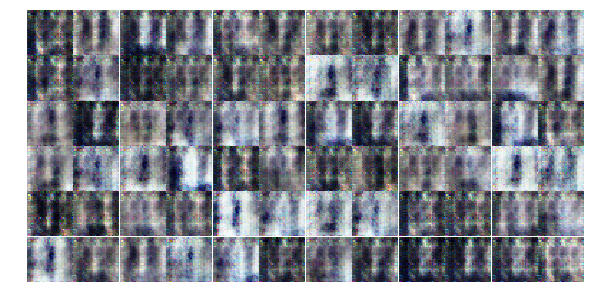

Epoch 6/25... Discriminator Loss: 1.2996... Generator Loss: 0.7400
Epoch 6/25... Discriminator Loss: 1.3097... Generator Loss: 0.7521
Epoch 6/25... Discriminator Loss: 1.2703... Generator Loss: 0.7861
Epoch 6/25... Discriminator Loss: 1.2276... Generator Loss: 0.8278
Epoch 6/25... Discriminator Loss: 1.3098... Generator Loss: 0.7572
Epoch 6/25... Discriminator Loss: 1.3243... Generator Loss: 0.7188
Epoch 6/25... Discriminator Loss: 1.2713... Generator Loss: 0.7468
Epoch 6/25... Discriminator Loss: 1.2606... Generator Loss: 0.7707
Epoch 6/25... Discriminator Loss: 1.2662... Generator Loss: 0.7723
Epoch 6/25... Discriminator Loss: 1.0942... Generator Loss: 0.9428


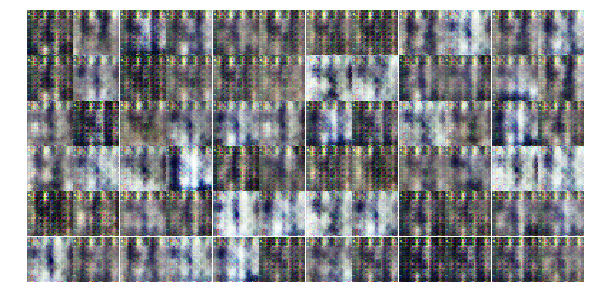

Epoch 6/25... Discriminator Loss: 1.2232... Generator Loss: 0.7572
Epoch 6/25... Discriminator Loss: 1.1400... Generator Loss: 0.8371
Epoch 6/25... Discriminator Loss: 1.1992... Generator Loss: 0.7940
Epoch 6/25... Discriminator Loss: 1.1617... Generator Loss: 0.7333
Epoch 6/25... Discriminator Loss: 1.2560... Generator Loss: 0.7262
Epoch 6/25... Discriminator Loss: 1.2556... Generator Loss: 0.7777
Epoch 6/25... Discriminator Loss: 1.2536... Generator Loss: 0.7568
Epoch 6/25... Discriminator Loss: 1.1609... Generator Loss: 0.7852
Epoch 6/25... Discriminator Loss: 1.1340... Generator Loss: 0.8704
Epoch 6/25... Discriminator Loss: 1.3233... Generator Loss: 0.6875


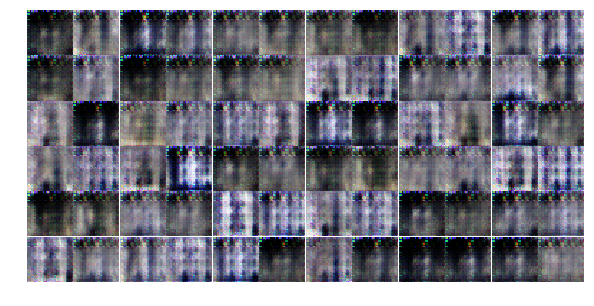

Epoch 6/25... Discriminator Loss: 1.2959... Generator Loss: 0.6769
Epoch 6/25... Discriminator Loss: 1.2711... Generator Loss: 0.7821
Epoch 6/25... Discriminator Loss: 1.1756... Generator Loss: 0.8607
Epoch 6/25... Discriminator Loss: 1.2514... Generator Loss: 0.8051
Epoch 6/25... Discriminator Loss: 1.2179... Generator Loss: 0.8723
Epoch 6/25... Discriminator Loss: 1.3123... Generator Loss: 0.6348
Epoch 6/25... Discriminator Loss: 1.3012... Generator Loss: 0.7080
Epoch 6/25... Discriminator Loss: 1.2097... Generator Loss: 0.7949
Epoch 6/25... Discriminator Loss: 1.1935... Generator Loss: 0.8009
Epoch 6/25... Discriminator Loss: 1.1259... Generator Loss: 0.8850


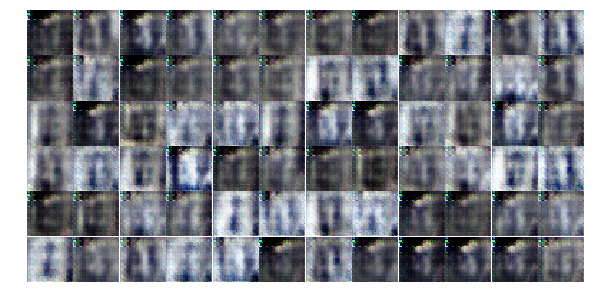

Epoch 6/25... Discriminator Loss: 1.1555... Generator Loss: 0.7553
Epoch 6/25... Discriminator Loss: 1.2824... Generator Loss: 0.6841
Epoch 6/25... Discriminator Loss: 1.0492... Generator Loss: 0.9916
Epoch 6/25... Discriminator Loss: 1.0814... Generator Loss: 0.9020
Epoch 6/25... Discriminator Loss: 0.9861... Generator Loss: 0.9157
Epoch 6/25... Discriminator Loss: 1.0769... Generator Loss: 0.8873
Epoch 6/25... Discriminator Loss: 1.1186... Generator Loss: 0.7042
Epoch 6/25... Discriminator Loss: 1.0536... Generator Loss: 1.1173
Epoch 6/25... Discriminator Loss: 0.9867... Generator Loss: 0.8845
Epoch 6/25... Discriminator Loss: 1.0213... Generator Loss: 0.8645


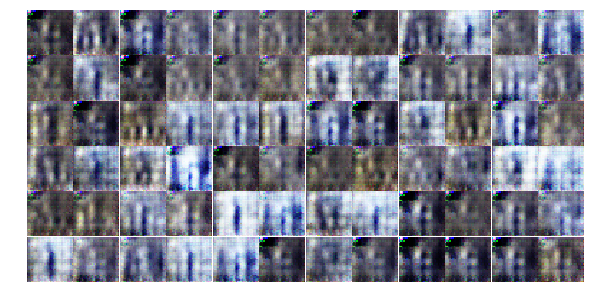

Epoch 6/25... Discriminator Loss: 1.1970... Generator Loss: 0.6990
Epoch 6/25... Discriminator Loss: 1.2606... Generator Loss: 0.9175
Epoch 6/25... Discriminator Loss: 1.0493... Generator Loss: 0.8167
Epoch 6/25... Discriminator Loss: 1.1612... Generator Loss: 0.7167
Epoch 6/25... Discriminator Loss: 1.0370... Generator Loss: 0.8459
Epoch 6/25... Discriminator Loss: 1.0822... Generator Loss: 0.8195
Epoch 6/25... Discriminator Loss: 0.8733... Generator Loss: 1.0496
Epoch 6/25... Discriminator Loss: 1.1792... Generator Loss: 0.5836
Epoch 6/25... Discriminator Loss: 1.5269... Generator Loss: 0.4677
Epoch 6/25... Discriminator Loss: 1.2124... Generator Loss: 0.9601


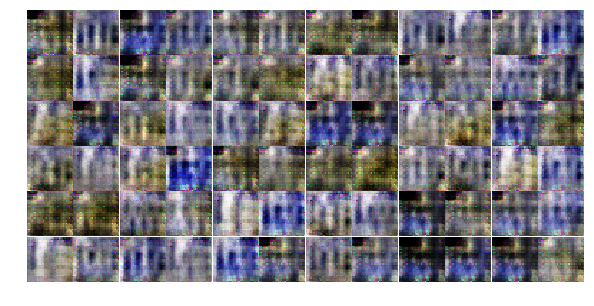

Epoch 6/25... Discriminator Loss: 1.0397... Generator Loss: 1.0911
Epoch 6/25... Discriminator Loss: 1.0804... Generator Loss: 1.1305
Epoch 6/25... Discriminator Loss: 1.1453... Generator Loss: 0.7831
Epoch 7/25... Discriminator Loss: 1.1887... Generator Loss: 1.0035
Epoch 7/25... Discriminator Loss: 1.0911... Generator Loss: 0.8945
Epoch 7/25... Discriminator Loss: 0.9486... Generator Loss: 0.9854
Epoch 7/25... Discriminator Loss: 1.2129... Generator Loss: 1.1847
Epoch 7/25... Discriminator Loss: 1.2528... Generator Loss: 0.7768
Epoch 7/25... Discriminator Loss: 1.3118... Generator Loss: 0.5997
Epoch 7/25... Discriminator Loss: 1.3837... Generator Loss: 0.5189


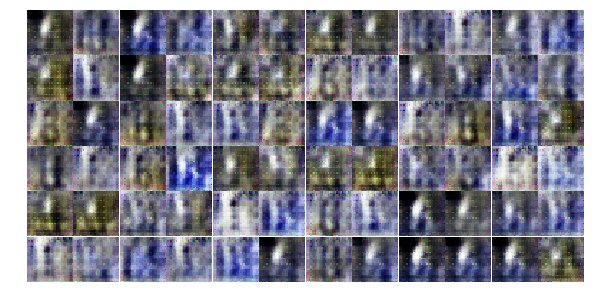

Epoch 7/25... Discriminator Loss: 0.9995... Generator Loss: 1.3680
Epoch 7/25... Discriminator Loss: 1.0358... Generator Loss: 1.0104
Epoch 7/25... Discriminator Loss: 1.1091... Generator Loss: 0.8658
Epoch 7/25... Discriminator Loss: 0.4107... Generator Loss: 2.1838
Epoch 7/25... Discriminator Loss: 1.0469... Generator Loss: 1.0149
Epoch 7/25... Discriminator Loss: 1.2055... Generator Loss: 0.9548
Epoch 7/25... Discriminator Loss: 0.9920... Generator Loss: 1.0573
Epoch 7/25... Discriminator Loss: 0.9986... Generator Loss: 0.9036
Epoch 7/25... Discriminator Loss: 1.1269... Generator Loss: 1.0113
Epoch 7/25... Discriminator Loss: 1.2265... Generator Loss: 0.8474


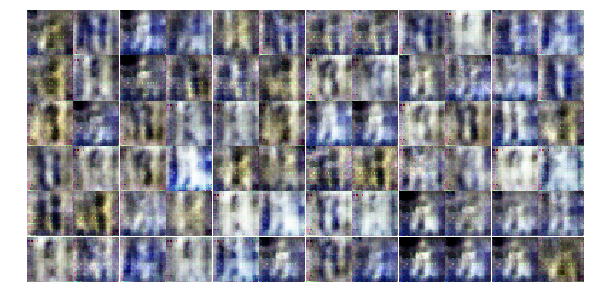

Epoch 7/25... Discriminator Loss: 0.9268... Generator Loss: 1.6562
Epoch 7/25... Discriminator Loss: 1.3727... Generator Loss: 0.5984
Epoch 7/25... Discriminator Loss: 1.0026... Generator Loss: 1.3589
Epoch 7/25... Discriminator Loss: 1.1739... Generator Loss: 1.6144
Epoch 7/25... Discriminator Loss: 1.3930... Generator Loss: 0.9299
Epoch 7/25... Discriminator Loss: 0.9987... Generator Loss: 0.9595
Epoch 7/25... Discriminator Loss: 1.2038... Generator Loss: 0.9524
Epoch 7/25... Discriminator Loss: 0.8151... Generator Loss: 1.1858
Epoch 7/25... Discriminator Loss: 1.5329... Generator Loss: 0.4815
Epoch 7/25... Discriminator Loss: 1.0890... Generator Loss: 1.1519


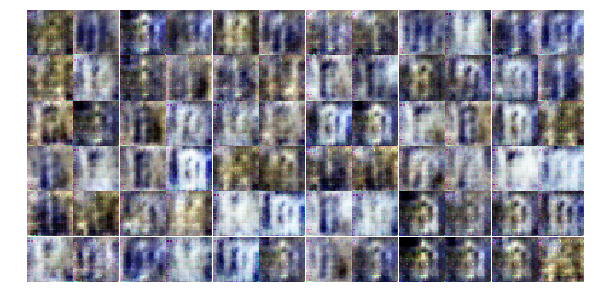

Epoch 7/25... Discriminator Loss: 1.1205... Generator Loss: 0.9883
Epoch 7/25... Discriminator Loss: 1.2466... Generator Loss: 0.7751
Epoch 7/25... Discriminator Loss: 1.2340... Generator Loss: 1.0228
Epoch 7/25... Discriminator Loss: 1.1542... Generator Loss: 0.7847
Epoch 7/25... Discriminator Loss: 0.9097... Generator Loss: 1.0434
Epoch 7/25... Discriminator Loss: 1.0607... Generator Loss: 0.8358
Epoch 7/25... Discriminator Loss: 1.2230... Generator Loss: 0.7865
Epoch 7/25... Discriminator Loss: 1.3680... Generator Loss: 0.9478
Epoch 7/25... Discriminator Loss: 1.4092... Generator Loss: 0.6546
Epoch 7/25... Discriminator Loss: 1.2731... Generator Loss: 0.9888


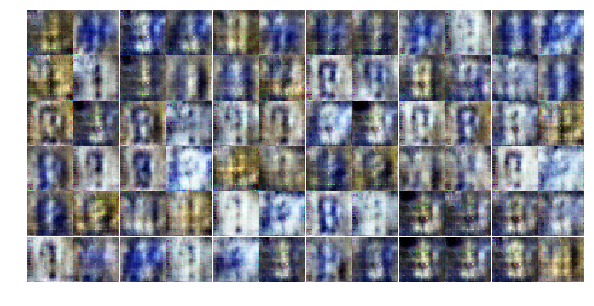

Epoch 7/25... Discriminator Loss: 1.1719... Generator Loss: 0.9273
Epoch 7/25... Discriminator Loss: 1.2353... Generator Loss: 0.8195
Epoch 7/25... Discriminator Loss: 1.1547... Generator Loss: 0.9893
Epoch 7/25... Discriminator Loss: 1.3581... Generator Loss: 0.5814
Epoch 7/25... Discriminator Loss: 1.4258... Generator Loss: 0.7807
Epoch 7/25... Discriminator Loss: 1.3468... Generator Loss: 0.9241
Epoch 7/25... Discriminator Loss: 1.3021... Generator Loss: 0.7974
Epoch 7/25... Discriminator Loss: 1.2966... Generator Loss: 0.7293
Epoch 7/25... Discriminator Loss: 1.1905... Generator Loss: 0.7477
Epoch 7/25... Discriminator Loss: 1.4404... Generator Loss: 0.6877


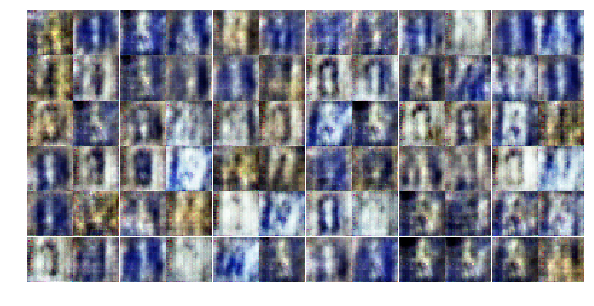

Epoch 7/25... Discriminator Loss: 0.9360... Generator Loss: 1.3034
Epoch 7/25... Discriminator Loss: 1.2226... Generator Loss: 1.2414
Epoch 7/25... Discriminator Loss: 1.3805... Generator Loss: 0.7519
Epoch 7/25... Discriminator Loss: 1.3724... Generator Loss: 0.6576
Epoch 7/25... Discriminator Loss: 1.2600... Generator Loss: 0.7001
Epoch 7/25... Discriminator Loss: 1.3315... Generator Loss: 0.6514
Epoch 7/25... Discriminator Loss: 1.0989... Generator Loss: 1.0297
Epoch 7/25... Discriminator Loss: 1.1381... Generator Loss: 0.9276
Epoch 7/25... Discriminator Loss: 1.3496... Generator Loss: 0.7993
Epoch 7/25... Discriminator Loss: 1.4290... Generator Loss: 0.5837


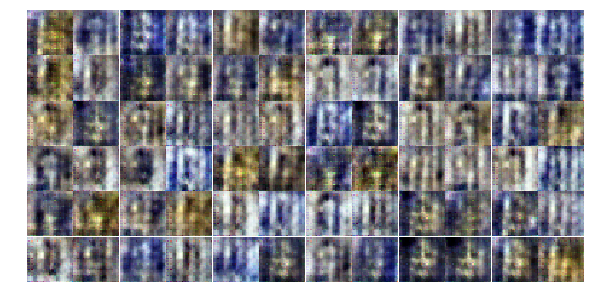

Epoch 7/25... Discriminator Loss: 1.2391... Generator Loss: 1.0214
Epoch 8/25... Discriminator Loss: 1.1232... Generator Loss: 1.1020
Epoch 8/25... Discriminator Loss: 1.4044... Generator Loss: 0.7036
Epoch 8/25... Discriminator Loss: 1.0911... Generator Loss: 0.9435
Epoch 8/25... Discriminator Loss: 1.3895... Generator Loss: 0.7220
Epoch 8/25... Discriminator Loss: 1.1903... Generator Loss: 0.8253
Epoch 8/25... Discriminator Loss: 1.2617... Generator Loss: 0.8958
Epoch 8/25... Discriminator Loss: 1.3962... Generator Loss: 0.7384
Epoch 8/25... Discriminator Loss: 1.1508... Generator Loss: 1.0603
Epoch 8/25... Discriminator Loss: 1.2030... Generator Loss: 0.7976


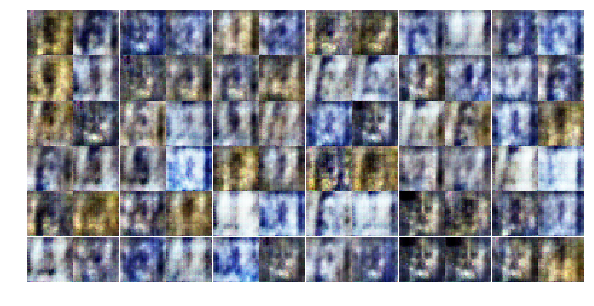

Epoch 8/25... Discriminator Loss: 1.3261... Generator Loss: 0.7919
Epoch 8/25... Discriminator Loss: 1.5122... Generator Loss: 0.6320
Epoch 8/25... Discriminator Loss: 1.5806... Generator Loss: 0.5097
Epoch 8/25... Discriminator Loss: 1.2342... Generator Loss: 0.9600
Epoch 8/25... Discriminator Loss: 1.3962... Generator Loss: 0.5607
Epoch 8/25... Discriminator Loss: 1.1547... Generator Loss: 0.9355
Epoch 8/25... Discriminator Loss: 1.3948... Generator Loss: 0.7686
Epoch 8/25... Discriminator Loss: 1.2683... Generator Loss: 0.7918
Epoch 8/25... Discriminator Loss: 1.3185... Generator Loss: 0.7851
Epoch 8/25... Discriminator Loss: 1.5233... Generator Loss: 0.6975


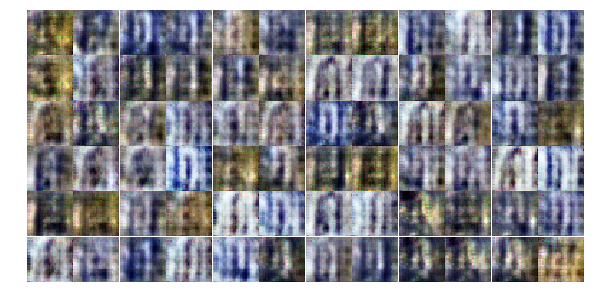

Epoch 8/25... Discriminator Loss: 1.3789... Generator Loss: 0.7244
Epoch 8/25... Discriminator Loss: 1.2695... Generator Loss: 0.7638
Epoch 8/25... Discriminator Loss: 1.2825... Generator Loss: 0.6540
Epoch 8/25... Discriminator Loss: 1.3238... Generator Loss: 0.6181
Epoch 8/25... Discriminator Loss: 1.2835... Generator Loss: 0.6635
Epoch 8/25... Discriminator Loss: 1.1982... Generator Loss: 0.6402
Epoch 8/25... Discriminator Loss: 1.2413... Generator Loss: 0.9329
Epoch 8/25... Discriminator Loss: 1.3499... Generator Loss: 0.7102
Epoch 8/25... Discriminator Loss: 1.3045... Generator Loss: 0.7913
Epoch 8/25... Discriminator Loss: 1.2977... Generator Loss: 0.8519


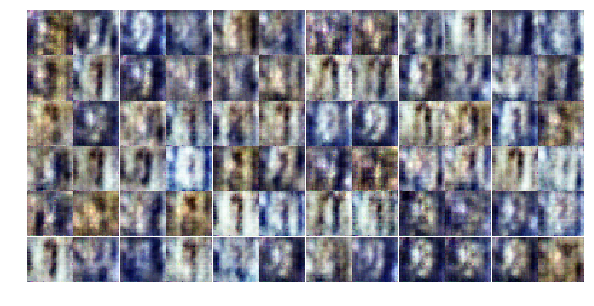

Epoch 8/25... Discriminator Loss: 1.3737... Generator Loss: 0.6999
Epoch 8/25... Discriminator Loss: 1.4201... Generator Loss: 0.7192
Epoch 8/25... Discriminator Loss: 1.2637... Generator Loss: 0.6194
Epoch 8/25... Discriminator Loss: 1.3934... Generator Loss: 0.7551
Epoch 8/25... Discriminator Loss: 1.3080... Generator Loss: 0.6992
Epoch 8/25... Discriminator Loss: 1.2973... Generator Loss: 0.8555
Epoch 8/25... Discriminator Loss: 1.4003... Generator Loss: 0.5998
Epoch 8/25... Discriminator Loss: 1.3123... Generator Loss: 0.6590
Epoch 8/25... Discriminator Loss: 1.3112... Generator Loss: 0.7732
Epoch 8/25... Discriminator Loss: 0.7951... Generator Loss: 1.4528


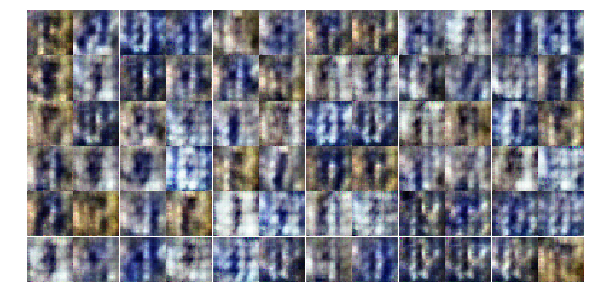

Epoch 8/25... Discriminator Loss: 1.4277... Generator Loss: 0.7797
Epoch 8/25... Discriminator Loss: 1.3939... Generator Loss: 0.6779
Epoch 8/25... Discriminator Loss: 1.2492... Generator Loss: 0.9192
Epoch 8/25... Discriminator Loss: 1.2504... Generator Loss: 0.8767
Epoch 8/25... Discriminator Loss: 1.3858... Generator Loss: 0.6495
Epoch 8/25... Discriminator Loss: 1.2983... Generator Loss: 0.7536
Epoch 8/25... Discriminator Loss: 1.3017... Generator Loss: 0.7582
Epoch 8/25... Discriminator Loss: 1.3597... Generator Loss: 0.7233
Epoch 8/25... Discriminator Loss: 0.9138... Generator Loss: 1.6119
Epoch 8/25... Discriminator Loss: 1.3071... Generator Loss: 0.9146


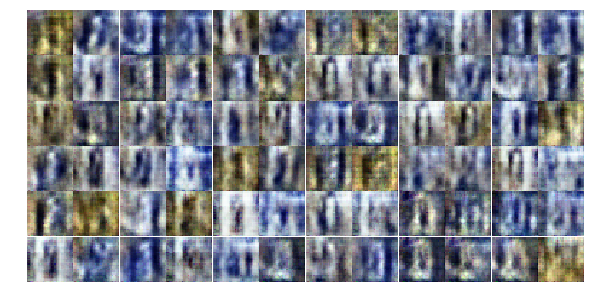

Epoch 8/25... Discriminator Loss: 1.0994... Generator Loss: 0.8961
Epoch 8/25... Discriminator Loss: 1.3346... Generator Loss: 0.7482
Epoch 8/25... Discriminator Loss: 1.3839... Generator Loss: 0.7093
Epoch 8/25... Discriminator Loss: 1.3520... Generator Loss: 0.6578
Epoch 8/25... Discriminator Loss: 1.3500... Generator Loss: 0.7348
Epoch 8/25... Discriminator Loss: 1.1843... Generator Loss: 0.9872
Epoch 8/25... Discriminator Loss: 1.4200... Generator Loss: 0.7319
Epoch 8/25... Discriminator Loss: 1.2025... Generator Loss: 0.7307
Epoch 9/25... Discriminator Loss: 1.4035... Generator Loss: 0.5768
Epoch 9/25... Discriminator Loss: 1.3798... Generator Loss: 0.6659


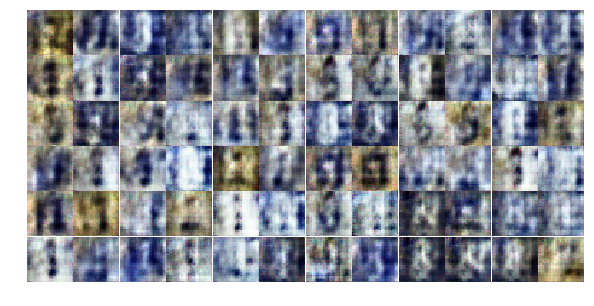

Epoch 9/25... Discriminator Loss: 1.1107... Generator Loss: 0.9861
Epoch 9/25... Discriminator Loss: 1.4890... Generator Loss: 0.6764
Epoch 9/25... Discriminator Loss: 1.3295... Generator Loss: 0.8154
Epoch 9/25... Discriminator Loss: 1.3253... Generator Loss: 0.6515
Epoch 9/25... Discriminator Loss: 1.2986... Generator Loss: 0.7615
Epoch 9/25... Discriminator Loss: 1.3343... Generator Loss: 0.7568
Epoch 9/25... Discriminator Loss: 1.4240... Generator Loss: 0.6992
Epoch 9/25... Discriminator Loss: 1.4074... Generator Loss: 0.6955
Epoch 9/25... Discriminator Loss: 1.3882... Generator Loss: 0.7608
Epoch 9/25... Discriminator Loss: 1.3691... Generator Loss: 0.8107


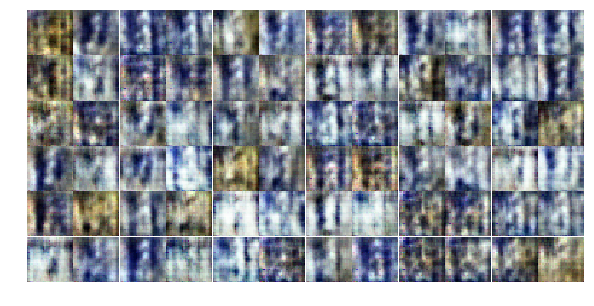

Epoch 9/25... Discriminator Loss: 1.3909... Generator Loss: 0.7074
Epoch 9/25... Discriminator Loss: 1.4299... Generator Loss: 0.7058
Epoch 9/25... Discriminator Loss: 1.3915... Generator Loss: 0.7273
Epoch 9/25... Discriminator Loss: 1.4406... Generator Loss: 0.7259
Epoch 9/25... Discriminator Loss: 1.3607... Generator Loss: 0.7560
Epoch 9/25... Discriminator Loss: 1.4105... Generator Loss: 0.6968
Epoch 9/25... Discriminator Loss: 1.4419... Generator Loss: 0.6846
Epoch 9/25... Discriminator Loss: 1.2124... Generator Loss: 0.9333
Epoch 9/25... Discriminator Loss: 1.4678... Generator Loss: 0.6596
Epoch 9/25... Discriminator Loss: 1.3898... Generator Loss: 0.7495


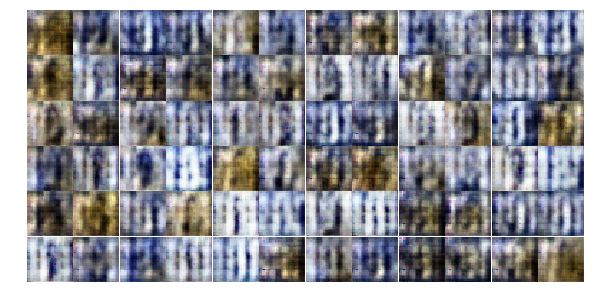

Epoch 9/25... Discriminator Loss: 1.3641... Generator Loss: 0.7064
Epoch 9/25... Discriminator Loss: 1.3908... Generator Loss: 0.7059
Epoch 9/25... Discriminator Loss: 1.2342... Generator Loss: 0.9003
Epoch 9/25... Discriminator Loss: 1.3657... Generator Loss: 0.7262
Epoch 9/25... Discriminator Loss: 1.4069... Generator Loss: 0.6775
Epoch 9/25... Discriminator Loss: 1.3799... Generator Loss: 0.7121
Epoch 9/25... Discriminator Loss: 1.5001... Generator Loss: 0.6622
Epoch 9/25... Discriminator Loss: 1.2776... Generator Loss: 0.7511
Epoch 9/25... Discriminator Loss: 1.3497... Generator Loss: 0.7053
Epoch 9/25... Discriminator Loss: 1.3529... Generator Loss: 0.7257


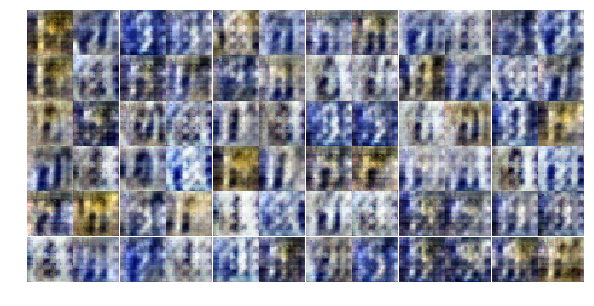

Epoch 9/25... Discriminator Loss: 1.4183... Generator Loss: 0.7254
Epoch 9/25... Discriminator Loss: 1.3822... Generator Loss: 0.7060
Epoch 9/25... Discriminator Loss: 1.3764... Generator Loss: 0.7702
Epoch 9/25... Discriminator Loss: 1.4067... Generator Loss: 0.6790
Epoch 9/25... Discriminator Loss: 1.4333... Generator Loss: 0.7219
Epoch 9/25... Discriminator Loss: 1.2781... Generator Loss: 0.7546
Epoch 9/25... Discriminator Loss: 1.4550... Generator Loss: 0.7142
Epoch 9/25... Discriminator Loss: 1.4358... Generator Loss: 0.6989
Epoch 9/25... Discriminator Loss: 1.4332... Generator Loss: 0.6973
Epoch 9/25... Discriminator Loss: 1.3267... Generator Loss: 0.7461


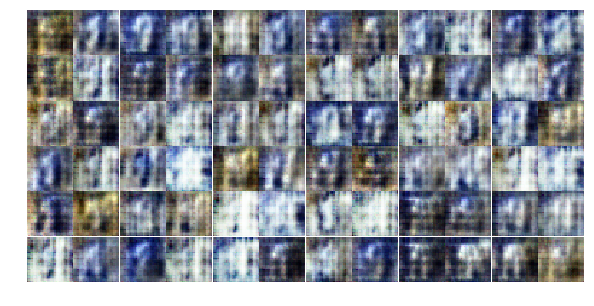

Epoch 9/25... Discriminator Loss: 1.3590... Generator Loss: 0.7222
Epoch 9/25... Discriminator Loss: 1.3774... Generator Loss: 0.7232
Epoch 9/25... Discriminator Loss: 1.3635... Generator Loss: 0.7258
Epoch 9/25... Discriminator Loss: 1.4437... Generator Loss: 0.6877
Epoch 9/25... Discriminator Loss: 1.3598... Generator Loss: 0.7514
Epoch 9/25... Discriminator Loss: 1.3794... Generator Loss: 0.7141
Epoch 9/25... Discriminator Loss: 1.3833... Generator Loss: 0.7028
Epoch 9/25... Discriminator Loss: 1.3650... Generator Loss: 0.7255
Epoch 9/25... Discriminator Loss: 1.3734... Generator Loss: 0.7468
Epoch 9/25... Discriminator Loss: 1.3605... Generator Loss: 0.7206


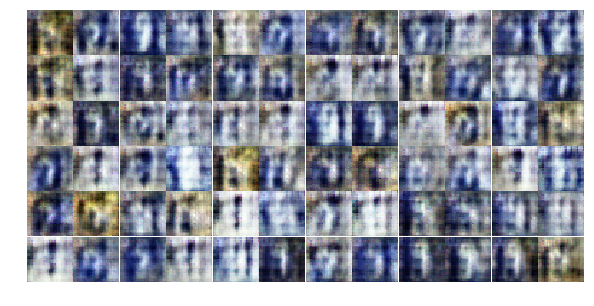

Epoch 9/25... Discriminator Loss: 1.3552... Generator Loss: 0.7163
Epoch 9/25... Discriminator Loss: 1.4484... Generator Loss: 0.6966
Epoch 9/25... Discriminator Loss: 1.3145... Generator Loss: 0.7564
Epoch 9/25... Discriminator Loss: 1.3782... Generator Loss: 0.7073
Epoch 9/25... Discriminator Loss: 1.3956... Generator Loss: 0.7082
Epoch 10/25... Discriminator Loss: 1.3647... Generator Loss: 0.7386
Epoch 10/25... Discriminator Loss: 1.3953... Generator Loss: 0.7081
Epoch 10/25... Discriminator Loss: 1.3279... Generator Loss: 0.7201
Epoch 10/25... Discriminator Loss: 1.3742... Generator Loss: 0.7264
Epoch 10/25... Discriminator Loss: 1.3681... Generator Loss: 0.6993


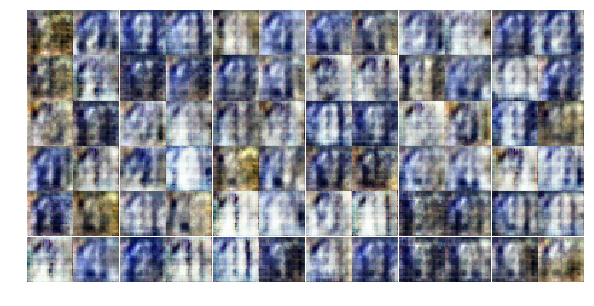

Epoch 10/25... Discriminator Loss: 1.2456... Generator Loss: 0.7296
Epoch 10/25... Discriminator Loss: 1.3818... Generator Loss: 0.7073
Epoch 10/25... Discriminator Loss: 1.4033... Generator Loss: 0.7354
Epoch 10/25... Discriminator Loss: 1.3363... Generator Loss: 0.7678
Epoch 10/25... Discriminator Loss: 1.3770... Generator Loss: 0.7245
Epoch 10/25... Discriminator Loss: 1.3534... Generator Loss: 0.7336
Epoch 10/25... Discriminator Loss: 1.3642... Generator Loss: 0.7207
Epoch 10/25... Discriminator Loss: 1.4423... Generator Loss: 0.6915
Epoch 10/25... Discriminator Loss: 1.3811... Generator Loss: 0.7098
Epoch 10/25... Discriminator Loss: 1.3624... Generator Loss: 0.7242


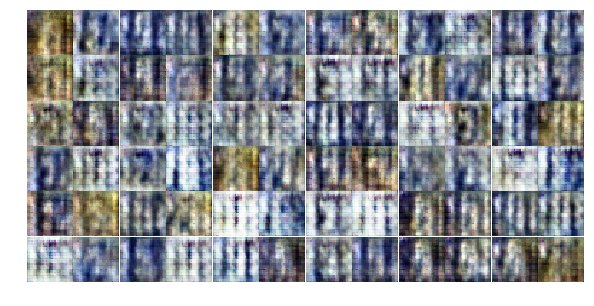

Epoch 10/25... Discriminator Loss: 1.2227... Generator Loss: 0.7968
Epoch 10/25... Discriminator Loss: 1.3069... Generator Loss: 0.7244
Epoch 10/25... Discriminator Loss: 1.3880... Generator Loss: 0.7201
Epoch 10/25... Discriminator Loss: 1.3974... Generator Loss: 0.7306
Epoch 10/25... Discriminator Loss: 1.3871... Generator Loss: 0.7300
Epoch 10/25... Discriminator Loss: 1.3551... Generator Loss: 0.7587
Epoch 10/25... Discriminator Loss: 1.2775... Generator Loss: 0.7701
Epoch 10/25... Discriminator Loss: 1.2594... Generator Loss: 0.7694
Epoch 10/25... Discriminator Loss: 1.3377... Generator Loss: 0.7331
Epoch 10/25... Discriminator Loss: 1.3654... Generator Loss: 0.7301


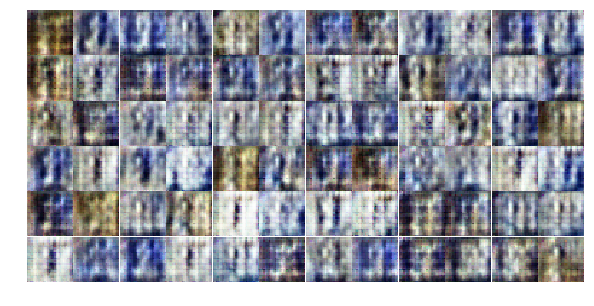

Epoch 10/25... Discriminator Loss: 1.3709... Generator Loss: 0.7086
Epoch 10/25... Discriminator Loss: 1.3561... Generator Loss: 0.7259
Epoch 10/25... Discriminator Loss: 1.3181... Generator Loss: 0.7473
Epoch 10/25... Discriminator Loss: 1.3585... Generator Loss: 0.7392
Epoch 10/25... Discriminator Loss: 1.3365... Generator Loss: 0.7372
Epoch 10/25... Discriminator Loss: 1.2765... Generator Loss: 0.7701
Epoch 10/25... Discriminator Loss: 1.3595... Generator Loss: 0.7192
Epoch 10/25... Discriminator Loss: 1.3998... Generator Loss: 0.6743
Epoch 10/25... Discriminator Loss: 1.3516... Generator Loss: 0.7212
Epoch 10/25... Discriminator Loss: 1.3382... Generator Loss: 0.7289


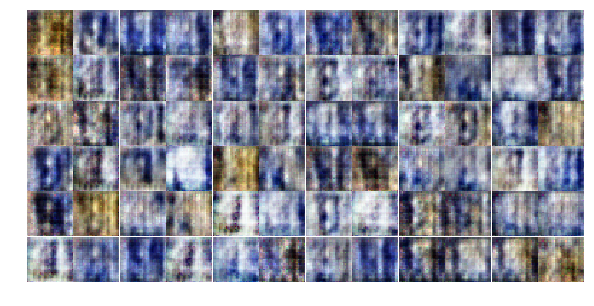

Epoch 10/25... Discriminator Loss: 1.3601... Generator Loss: 0.7349
Epoch 10/25... Discriminator Loss: 1.3042... Generator Loss: 0.7702
Epoch 10/25... Discriminator Loss: 1.3720... Generator Loss: 0.7400
Epoch 10/25... Discriminator Loss: 1.3378... Generator Loss: 0.7475
Epoch 10/25... Discriminator Loss: 1.3311... Generator Loss: 0.7297
Epoch 10/25... Discriminator Loss: 1.3912... Generator Loss: 0.7231
Epoch 10/25... Discriminator Loss: 1.3082... Generator Loss: 0.7511
Epoch 10/25... Discriminator Loss: 1.3353... Generator Loss: 0.7438
Epoch 10/25... Discriminator Loss: 1.3079... Generator Loss: 0.7536
Epoch 10/25... Discriminator Loss: 1.3433... Generator Loss: 0.7234


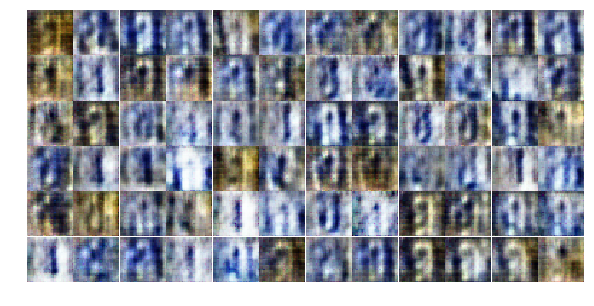

Epoch 10/25... Discriminator Loss: 1.3766... Generator Loss: 0.7457
Epoch 10/25... Discriminator Loss: 1.3195... Generator Loss: 0.7710
Epoch 10/25... Discriminator Loss: 1.3764... Generator Loss: 0.7007
Epoch 10/25... Discriminator Loss: 1.3548... Generator Loss: 0.7382
Epoch 10/25... Discriminator Loss: 1.3836... Generator Loss: 0.7078
Epoch 10/25... Discriminator Loss: 1.3679... Generator Loss: 0.7098
Epoch 10/25... Discriminator Loss: 1.2420... Generator Loss: 0.7702
Epoch 10/25... Discriminator Loss: 1.3525... Generator Loss: 0.7083
Epoch 10/25... Discriminator Loss: 1.3616... Generator Loss: 0.7277
Epoch 10/25... Discriminator Loss: 1.3647... Generator Loss: 0.7529


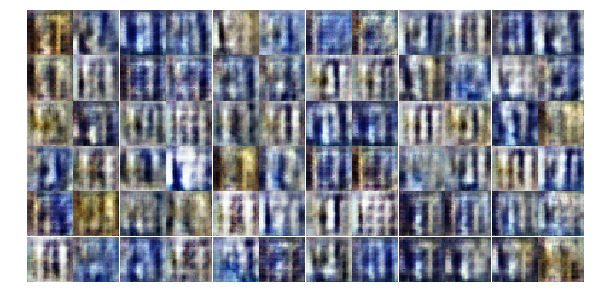

Epoch 10/25... Discriminator Loss: 1.3180... Generator Loss: 0.7384
Epoch 10/25... Discriminator Loss: 1.3734... Generator Loss: 0.7194
Epoch 10/25... Discriminator Loss: 1.3346... Generator Loss: 0.7669
Epoch 11/25... Discriminator Loss: 1.4025... Generator Loss: 0.7015
Epoch 11/25... Discriminator Loss: 1.3070... Generator Loss: 0.7495
Epoch 11/25... Discriminator Loss: 1.4149... Generator Loss: 0.6972
Epoch 11/25... Discriminator Loss: 1.2724... Generator Loss: 0.7806
Epoch 11/25... Discriminator Loss: 1.3873... Generator Loss: 0.7104
Epoch 11/25... Discriminator Loss: 1.3389... Generator Loss: 0.7537
Epoch 11/25... Discriminator Loss: 1.3678... Generator Loss: 0.7074


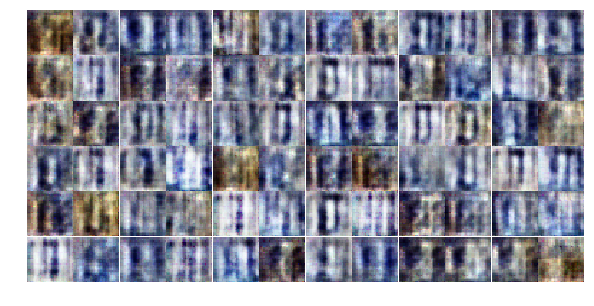

Epoch 11/25... Discriminator Loss: 1.3307... Generator Loss: 0.7616
Epoch 11/25... Discriminator Loss: 1.3369... Generator Loss: 0.7121
Epoch 11/25... Discriminator Loss: 1.3352... Generator Loss: 0.7441
Epoch 11/25... Discriminator Loss: 1.3535... Generator Loss: 0.7182
Epoch 11/25... Discriminator Loss: 1.4172... Generator Loss: 0.7166
Epoch 11/25... Discriminator Loss: 1.4053... Generator Loss: 0.7140
Epoch 11/25... Discriminator Loss: 1.2583... Generator Loss: 0.7911
Epoch 11/25... Discriminator Loss: 1.4173... Generator Loss: 0.6615
Epoch 11/25... Discriminator Loss: 1.3336... Generator Loss: 0.7617
Epoch 11/25... Discriminator Loss: 1.3014... Generator Loss: 0.7801


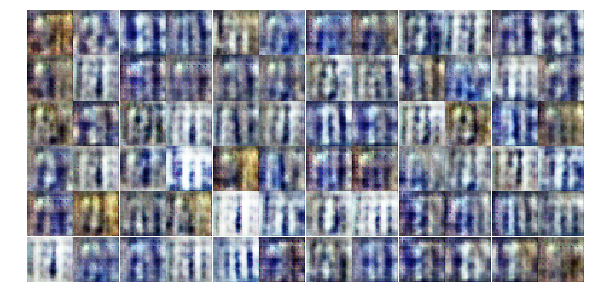

Epoch 11/25... Discriminator Loss: 1.3855... Generator Loss: 0.7038
Epoch 11/25... Discriminator Loss: 1.4263... Generator Loss: 0.7264
Epoch 11/25... Discriminator Loss: 1.2981... Generator Loss: 0.7339
Epoch 11/25... Discriminator Loss: 1.3254... Generator Loss: 0.7226
Epoch 11/25... Discriminator Loss: 1.3231... Generator Loss: 0.7220
Epoch 11/25... Discriminator Loss: 1.3759... Generator Loss: 0.7518
Epoch 11/25... Discriminator Loss: 1.3662... Generator Loss: 0.7308
Epoch 11/25... Discriminator Loss: 1.3092... Generator Loss: 0.7885
Epoch 11/25... Discriminator Loss: 1.3986... Generator Loss: 0.7168
Epoch 11/25... Discriminator Loss: 1.3198... Generator Loss: 0.7481


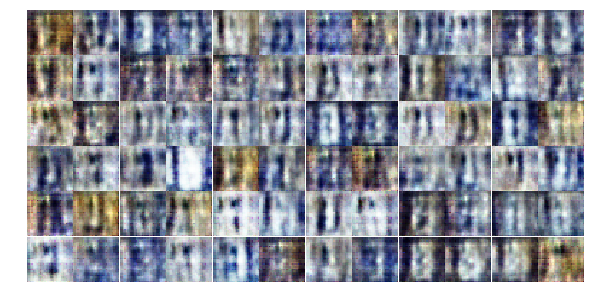

Epoch 11/25... Discriminator Loss: 1.3333... Generator Loss: 0.7391
Epoch 11/25... Discriminator Loss: 1.3324... Generator Loss: 0.7457
Epoch 11/25... Discriminator Loss: 1.3786... Generator Loss: 0.7146
Epoch 11/25... Discriminator Loss: 1.3267... Generator Loss: 0.7408
Epoch 11/25... Discriminator Loss: 1.3736... Generator Loss: 0.7206
Epoch 11/25... Discriminator Loss: 1.3019... Generator Loss: 0.7517
Epoch 11/25... Discriminator Loss: 1.3264... Generator Loss: 0.7328
Epoch 11/25... Discriminator Loss: 1.2722... Generator Loss: 0.7588
Epoch 11/25... Discriminator Loss: 1.3505... Generator Loss: 0.7301
Epoch 11/25... Discriminator Loss: 1.2903... Generator Loss: 0.7548


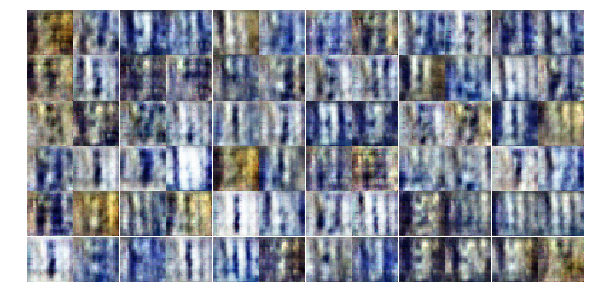

Epoch 11/25... Discriminator Loss: 1.3578... Generator Loss: 0.7263
Epoch 11/25... Discriminator Loss: 1.3159... Generator Loss: 0.7407
Epoch 11/25... Discriminator Loss: 1.3741... Generator Loss: 0.7335
Epoch 11/25... Discriminator Loss: 1.3269... Generator Loss: 0.7376
Epoch 11/25... Discriminator Loss: 1.3232... Generator Loss: 0.7549
Epoch 11/25... Discriminator Loss: 1.2719... Generator Loss: 0.7711
Epoch 11/25... Discriminator Loss: 1.4161... Generator Loss: 0.6881
Epoch 11/25... Discriminator Loss: 1.3285... Generator Loss: 0.7446
Epoch 11/25... Discriminator Loss: 1.3667... Generator Loss: 0.7337
Epoch 11/25... Discriminator Loss: 1.3112... Generator Loss: 0.7520


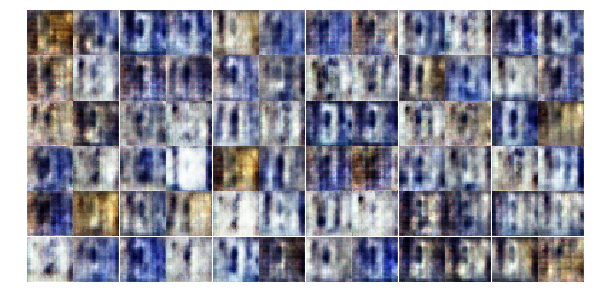

Epoch 11/25... Discriminator Loss: 1.3285... Generator Loss: 0.7474
Epoch 11/25... Discriminator Loss: 1.2967... Generator Loss: 0.7495
Epoch 11/25... Discriminator Loss: 1.4361... Generator Loss: 0.6891
Epoch 11/25... Discriminator Loss: 1.2919... Generator Loss: 0.7588
Epoch 11/25... Discriminator Loss: 1.2920... Generator Loss: 0.7558
Epoch 11/25... Discriminator Loss: 1.3117... Generator Loss: 0.7627
Epoch 11/25... Discriminator Loss: 1.4308... Generator Loss: 0.6971
Epoch 11/25... Discriminator Loss: 1.3149... Generator Loss: 0.7714
Epoch 11/25... Discriminator Loss: 1.3535... Generator Loss: 0.7416
Epoch 11/25... Discriminator Loss: 1.3022... Generator Loss: 0.7496


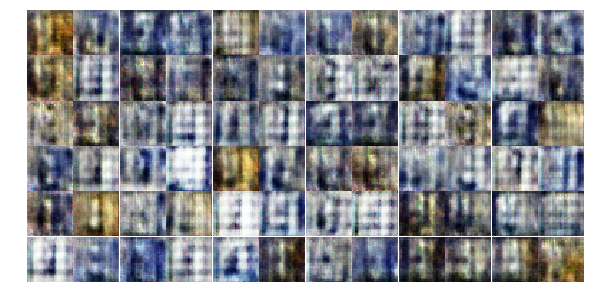

Epoch 12/25... Discriminator Loss: 1.3396... Generator Loss: 0.7277
Epoch 12/25... Discriminator Loss: 1.3630... Generator Loss: 0.7277
Epoch 12/25... Discriminator Loss: 1.3605... Generator Loss: 0.7360
Epoch 12/25... Discriminator Loss: 1.3840... Generator Loss: 0.7157
Epoch 12/25... Discriminator Loss: 1.2630... Generator Loss: 0.7761
Epoch 12/25... Discriminator Loss: 1.3938... Generator Loss: 0.7103
Epoch 12/25... Discriminator Loss: 1.3013... Generator Loss: 0.7482
Epoch 12/25... Discriminator Loss: 1.3588... Generator Loss: 0.7325
Epoch 12/25... Discriminator Loss: 1.3437... Generator Loss: 0.7399
Epoch 12/25... Discriminator Loss: 1.3442... Generator Loss: 0.7582


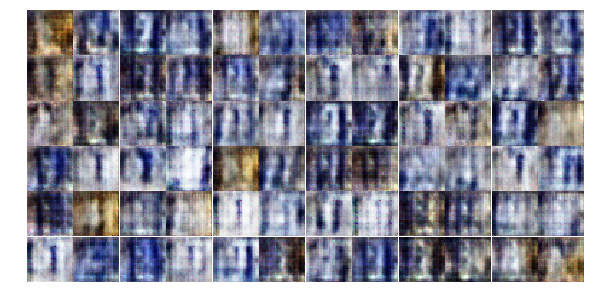

Epoch 12/25... Discriminator Loss: 1.2883... Generator Loss: 0.7688
Epoch 12/25... Discriminator Loss: 1.4024... Generator Loss: 0.6884
Epoch 12/25... Discriminator Loss: 1.2831... Generator Loss: 0.7875
Epoch 12/25... Discriminator Loss: 1.3918... Generator Loss: 0.7157
Epoch 12/25... Discriminator Loss: 1.3102... Generator Loss: 0.7796
Epoch 12/25... Discriminator Loss: 1.3243... Generator Loss: 0.7294
Epoch 12/25... Discriminator Loss: 1.3784... Generator Loss: 0.7100
Epoch 12/25... Discriminator Loss: 1.3507... Generator Loss: 0.7250
Epoch 12/25... Discriminator Loss: 1.2910... Generator Loss: 0.7577
Epoch 12/25... Discriminator Loss: 1.4188... Generator Loss: 0.7017


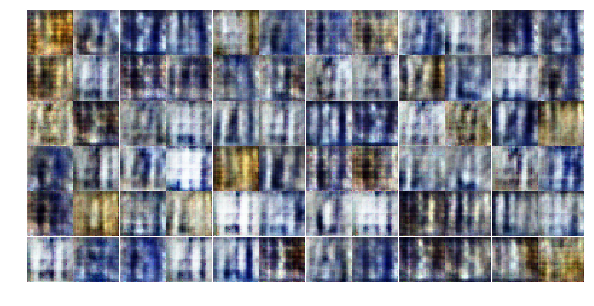

Epoch 12/25... Discriminator Loss: 1.3142... Generator Loss: 0.7416
Epoch 12/25... Discriminator Loss: 1.3215... Generator Loss: 0.7213
Epoch 12/25... Discriminator Loss: 1.3586... Generator Loss: 0.7119
Epoch 12/25... Discriminator Loss: 1.3774... Generator Loss: 0.7283
Epoch 12/25... Discriminator Loss: 1.3348... Generator Loss: 0.7485
Epoch 12/25... Discriminator Loss: 1.3788... Generator Loss: 0.7482
Epoch 12/25... Discriminator Loss: 1.3135... Generator Loss: 0.7565
Epoch 12/25... Discriminator Loss: 1.3396... Generator Loss: 0.7502
Epoch 12/25... Discriminator Loss: 1.3627... Generator Loss: 0.7359
Epoch 12/25... Discriminator Loss: 1.3977... Generator Loss: 0.7048


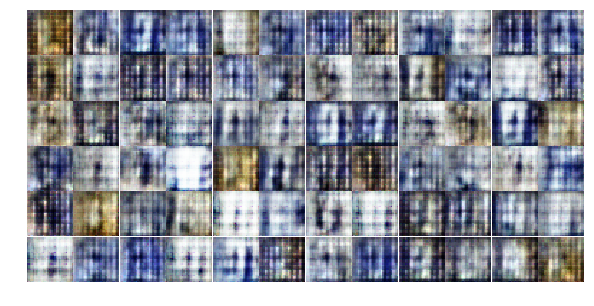

Epoch 12/25... Discriminator Loss: 1.3294... Generator Loss: 0.7765
Epoch 12/25... Discriminator Loss: 1.3615... Generator Loss: 0.7364
Epoch 12/25... Discriminator Loss: 1.3056... Generator Loss: 0.7589
Epoch 12/25... Discriminator Loss: 1.3101... Generator Loss: 0.7447
Epoch 12/25... Discriminator Loss: 1.3462... Generator Loss: 0.7310
Epoch 12/25... Discriminator Loss: 1.3163... Generator Loss: 0.7674
Epoch 12/25... Discriminator Loss: 1.3325... Generator Loss: 0.7288
Epoch 12/25... Discriminator Loss: 1.3252... Generator Loss: 0.7433
Epoch 12/25... Discriminator Loss: 1.3512... Generator Loss: 0.7257
Epoch 12/25... Discriminator Loss: 1.3326... Generator Loss: 0.7420


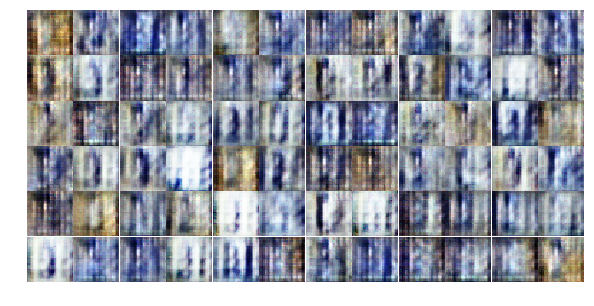

Epoch 12/25... Discriminator Loss: 1.2616... Generator Loss: 0.7796
Epoch 12/25... Discriminator Loss: 1.3525... Generator Loss: 0.7304
Epoch 12/25... Discriminator Loss: 1.3488... Generator Loss: 0.7537
Epoch 12/25... Discriminator Loss: 1.3829... Generator Loss: 0.7251
Epoch 12/25... Discriminator Loss: 1.3346... Generator Loss: 0.7667
Epoch 12/25... Discriminator Loss: 1.3803... Generator Loss: 0.7089


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))